# Bando Traffic Model with Mesa-Geo

This notebook implements the Bando Optimal Velocity traffic model using the Mesa-Geo agent-based modeling framework.

## Table of Contents
1. [Introduction & Setup](#1-introduction--setup) - Imports and network data loading
2. [Model Core: Bando Dynamics](#2-model-core-bando-dynamics) - Mathematical functions for traffic flow
3. [Agent Definitions](#3-agent-definitions) - VehicleAgent and RoadAgent classes
4. [Model Class](#4-model-class) - Main BandoTrafficModel implementation
5. [Simulation & Analysis](#5-simulation--analysis) - Running simulations and analyzing results
6. [Visualization](#6-visualization) - Traffic maps and interactive views
7. [Experiments](#7-experiments) - Large-scale configurable simulations

---

## Model Overview

**Agents:**
- **VehicleAgent**: Individual vehicles following Bando dynamics
- **RoadAgent**: Road segments from Singapore road network managing vehicle flow

**Environment:** 
- Road network from OpenStreetMap (Singapore)
- GeoSpace for spatial interactions

**Dynamics:**
- Bando Optimal Velocity Model for car-following behavior
- Vehicles adjust speed based on distance to leading vehicle
- Highway-specific parameters and optional bottleneck effects

**Key Parameters:**
- `N`: Number of vehicles per road segment (varies by highway type)
- `tau`: Optimal velocity scaling parameter
- `alpha`: Sensitivity to optimal velocity vs neighbor velocity
- `epsilon`: Bottleneck strength
- `L`: Road segment length (normalized)

In [1]:
# Geospatial libraries
import osmnx as ox
import networkx as nx
import geopandas as gpd
from shapely.geometry import Point, LineString
import folium

# Data analysis
import numpy as np
import pandas as pd

# Mesa framework
import mesa
from mesa.visualization import SolaraViz, make_plot_component
import mesa_geo as mg
from mesa_geo.visualization import make_geospace_component

# Configuration
ox.settings.use_cache = True

/Library/Frameworks/Python.framework/Versions/3.12/lib/python3.12/site-packages/solara/validate_hooks.py:122: UserWarning: /Library/Frameworks/Python.framework/Versions/3.12/lib/python3.12/site-packages/mesa/visualization/solara_viz.py:399: ComponentsView: `use_state` found despite early return on line 376
To suppress this check, replace the line with:
    current_tab_index, set_current_tab_index = solara.use_state(0)  # noqa: SH101

Make sure you understand the consequences of this, by reading about the rules of hooks at:
    https://solara.dev/documentation/advanced/understanding/rules-of-hooks

  warnings.warn(str(e))


---

# 1. Introduction & Setup

## 1.1 Imports and Configuration

In [2]:
## 1.2 Load Singapore Road Network

# Build network from OpenStreetMap
G = ox.graph_from_place("Singapore", network_type="drive")
G = ox.add_edge_speeds(G)
G = ox.add_edge_travel_times(G)

# Convert to GeoDataFrame
edges_gdf = ox.graph_to_gdfs(G, nodes=False, fill_edge_geometry=True)

# Prepare edges DataFrame
if not {"u", "v", "key"}.issubset(edges_gdf.columns):
    edges_gdf = edges_gdf.reset_index()

# Select relevant columns
edge_cols = [c for c in ["u", "v", "key", "geometry", "length", "highway", "maxspeed", "speed_kph", "travel_time"]
             if c in edges_gdf.columns]
edges = edges_gdf[edge_cols].copy()
edges = edges.set_crs(4326) if edges.crs is None else edges.to_crs(4326)

print(f"Total edges loaded: {len(edges)}")
edges.head()

Total edges loaded: 45944


,u,v,key,geometry,length,highway,maxspeed,speed_kph,travel_time
0,25451929,6749812859,0,"LINESTRING (103.87254 1.29523, 103.87103 1.295...",765.027747,motorway,70,70.0,39.344284
1,25455287,1637003462,0,"LINESTRING (103.874 1.29544, 103.87413 1.2955,...",629.055082,motorway_link,50,50.0,45.291966
2,25455287,2521018789,0,"LINESTRING (103.874 1.29544, 103.87438 1.29544...",652.575579,motorway,90,90.0,26.103023
3,26777521,172424179,0,"LINESTRING (103.82357 1.30398, 103.82359 1.303...",113.995770,primary,40,40.0,10.259619
4,26777521,1889379421,0,"LINESTRING (103.82357 1.30398, 103.82372 1.304...",86.667744,residential,50,50.0,6.240078


---

# 2. Model Core: Bando Dynamics

The Bando Optimal Velocity Model describes car-following behavior where each vehicle adjusts its velocity based on the distance (headway) to the vehicle ahead.

**Core Equations:**
- **Optimal Velocity Function**: $V_{opt}(h) = \frac{\tau}{L} \frac{\tanh(h-2) + \tanh(2)}{1+\tanh(2)}$
- **Acceleration**: $\frac{dv}{dt} = \alpha [V_{opt}(h) - v_i] + (1-\alpha)[v_{i+1} - v_i]$

Where:
- $h$ = headway (distance to leading vehicle)
- $\tau$ = optimal velocity scaling parameter
- $\alpha$ = sensitivity to optimal velocity vs. neighbor velocity
- $L$ = road length (normalized)

In [3]:
def optimal_vel(h, tau, L):
    """Optimal velocity function - returns normalized velocity (0-1)"""
    opt_v = tau/L * (np.tanh(h-2) + np.tanh(2)) / (1+np.tanh(2))
    return opt_v

def optimal_vel_bottleneck(h, tau, L, x, epsilon):
    """Optimal velocity with bottleneck effect"""
    xi = x % L
    bottleneck_factor = (1 - epsilon * np.exp(- (xi - (L/2))**2 ))
    opt_v = optimal_vel(h, tau, L)
    return bottleneck_factor * opt_v

def bando_acceleration(x, v, N, tau, alpha, bottleneck, epsilon, L):
    """Calculate Bando model acceleration for all vehicles"""
    xi1, xi2 = x, np.append(x, x+L)[1:N+1]  # periodic boundary
    vi1, vi2 = v, np.append(v, v)[1:N+1]
    h = xi2 - xi1  # headway (distance to leading vehicle)

    if bottleneck:
        bando_term = optimal_vel_bottleneck(h, tau, L, x, epsilon) - vi1
    else:
        bando_term = optimal_vel(h, tau, L) - vi1

    aggre_term = vi2 - vi1
    acceleration = alpha * bando_term + (1-alpha) * aggre_term
    return acceleration

---

# 3. Agent Definitions

## 3.1 VehicleAgent Class

Individual vehicles that follow Bando dynamics along road segments. Each vehicle tracks:
- Position on road (normalized 0-1)
- Current velocity
- Reference to its road segment

In [4]:
class VehicleAgent(mg.GeoAgent):
    """Vehicle agent following Bando dynamics."""

    def __init__(self, model, geometry, crs, road_segment, position, velocity, vehicle_index):
        super().__init__(model, geometry, crs)
        self.road_segment = road_segment  # Reference to road agent
        self.position = position  # Position on road (0-1 normalized)
        self.velocity = velocity  # Current velocity (normalized)
        self.vehicle_index = vehicle_index  # Index in vehicle array
        self.acceleration = 0.0
        
    def __repr__(self):
        return f"Vehicle {self.unique_id} on road {self.road_segment.edge_id}"
    
    def update_position_on_road(self):
        """Update geometry based on normalized position along road."""
        # Get point along line at current position
        road_geom = self.road_segment.geometry
        point_on_road = road_geom.interpolate(self.position, normalized=True)
        self.geometry = point_on_road
    
    def step(self):
        """Update vehicle position based on Bando dynamics."""
        # Dynamics are calculated at road segment level
        # Individual vehicles just update their position
        self.update_position_on_road()

## 3.2 RoadAgent Class

Road segments that manage vehicle flow using Bando dynamics. Each road:
- Maintains arrays of vehicle positions and velocities
- Applies Bando equations to update all vehicles collectively
- Sets highway-specific parameters (tau, alpha, epsilon)
- Runs warmup simulation to reach steady-state before main simulation
- Tracks performance metrics (mean speed, speed ratio)

In [5]:
class RoadAgent(mg.GeoAgent):
    """Road segment agent managing vehicle flow."""
    
    def __init__(self, model, geometry, crs, edge_id, u, v, key, 
                 length_m, speed_kph, highway_type, num_vehicles):
        super().__init__(model, geometry, crs)
        self.edge_id = edge_id
        self.u = u
        self.v = v
        self.key = key
        self.length_m = length_m
        self.speed_kph = speed_kph
        self.highway_type = highway_type
        self.num_vehicles = num_vehicles
        
        # Bando parameters (highway-specific)
        self.set_bando_params()
        
        # Vehicle state arrays
        self.positions = None  # Vehicle positions (normalized 0-1)
        self.velocities = None  # Vehicle velocities (normalized 0-1)
        self.vehicles = []  # List of vehicle agents on this road
        
        # Velocity history for steady-state calculation
        self.velocity_history = []
        self.internal_step_count = 0
        self.warmup_steps = 0  # Will be set after initialization
        
        # Performance metrics
        self.mean_speed_kph = speed_kph  # Initialize to free flow
        self.speed_ratio = 1.0
        
    def set_bando_params(self):
        """Set Bando parameters based on highway type."""
        # highway_params = {
        #     'motorway': {'tau': 40, 'alpha': 0.9, 'epsilon': 0.2},
        #     'trunk': {'tau': 35, 'alpha': 0.85, 'epsilon': 0.3},
        #     'primary': {'tau': 30, 'alpha': 0.8, 'epsilon': 0.4},
        #     'secondary': {'tau': 25, 'alpha': 0.75, 'epsilon': 0.5},
        #     'tertiary': {'tau': 20, 'alpha': 0.7, 'epsilon': 0.6},
        #     'residential': {'tau': 15, 'alpha': 0.6, 'epsilon': 0.7}
        # }

        highway_params = {
        'motorway': {'tau': 60.0, 'alpha': 0.80, 'epsilon': 0.10},
        'trunk': {'tau': 52.5, 'alpha': 0.80, 'epsilon': 0.15},
        'primary': {'tau': 45.0, 'alpha': 0.80, 'epsilon': 0.20},
        'secondary': {'tau': 37.5, 'alpha': 0.80, 'epsilon': 0.25},
        'tertiary': {'tau': 30.0, 'alpha': 0.80, 'epsilon': 0.30},
        'residential': {'tau': 22.5, 'alpha': 0.80, 'epsilon': 0.35},
    }
        
        params = highway_params.get(self.highway_type, highway_params['residential'])
        self.tau = params['tau']
        self.alpha = params['alpha']
        self.epsilon = params['epsilon']
        self.L = 1.0  # Normalized length
        self.bottleneck = self.highway_type in ['motorway', 'trunk', 'primary']
        
    def initialize_vehicles(self):
        """Initialize vehicle positions and velocities."""
        N = self.num_vehicles
        
        # Initialize positions uniformly with small perturbation
        self.positions = np.linspace(0, self.L, N, endpoint=False)
        perturbation = self.model.rng.random(N) * 0.1
        self.positions = (self.positions + perturbation) % self.L
        
        # Initialize velocities
        if self.bottleneck:
            self.velocities = np.array([optimal_vel_bottleneck(self.L/N, self.tau, self.L, xi, self.epsilon) 
                                       for xi in self.positions])
        else:
            self.velocities = np.ones(N) * optimal_vel(self.L/N, self.tau, self.L)
        
        # Add small velocity perturbation
        perturbation_v = self.model.rng.random(N) * 0.05
        self.velocities = np.clip(self.velocities + perturbation_v, 0, None)
        
        # Run internal warmup simulation to reach steady state
        self._run_warmup_simulation()
        
    def _run_warmup_simulation(self, time_end=8.0, delta_t=0.005):
        """Run simulation to steady state before main simulation starts."""
        total_steps = int(time_end / delta_t)
        self.warmup_steps = int(0.75 * total_steps)  # Use last 25% for steady-state
        
        velocity_history = []
        
        for step in range(total_steps):
            # Calculate acceleration
            a = bando_acceleration(self.positions, self.velocities, self.num_vehicles,
                                  self.tau, self.alpha, self.bottleneck, self.epsilon, self.L)
            
            # Euler update
            self.positions = self.positions + delta_t * self.velocities
            self.velocities = self.velocities + delta_t * a
            
            # Periodic boundary conditions
            self.positions = self.positions % self.L
            self.velocities = np.clip(self.velocities, 0, None)
            
            # Store velocities after warmup
            if step >= self.warmup_steps:
                velocity_history.append(self.velocities.copy())
        
        # Calculate steady-state speed using same approach as sg_traffic_bando
        if len(velocity_history) > 0:
            v_steady = np.array(velocity_history)
            mean_v_normalized = np.mean(v_steady)
            
            # IMPROVED SCALING: Use target ratios with variation (matching sg_traffic_bando)
            # variation = (mean_v_normalized - 0.5) * 0.3  # ±15% variation around base
            # speed_ratio = self.base_ratio + variation
            # speed_ratio = np.clip(speed_ratio, 0.4, 1.1)  # realistic bounds
            
            # # Add some random traffic variation (matching sg_traffic_bando)
            # traffic_noise = self.model.rng.normal(0, 0.05)
            # speed_ratio += traffic_noise
            speed_ratio = mean_v_normalized
            speed_ratio = np.clip(speed_ratio, 0.3, 1.2)

            
            self.speed_ratio = speed_ratio
            self.mean_speed_kph = self.speed_kph * speed_ratio
        
    def update_bando_dynamics(self, delta_t=0.005):
        """Update vehicle dynamics using Bando model (Euler method)."""
        if self.num_vehicles == 0:
            return
            
        # Calculate acceleration
        a = bando_acceleration(self.positions, self.velocities, self.num_vehicles,
                              self.tau, self.alpha, self.bottleneck, self.epsilon, self.L)
        
        # Euler update
        self.positions = self.positions + delta_t * self.velocities
        self.velocities = self.velocities + delta_t * a
        
        # Periodic boundary conditions
        self.positions = self.positions % self.L
        self.velocities = np.clip(self.velocities, 0, None)
        
        # Store velocity history for ongoing analysis
        self.velocity_history.append(self.velocities.copy())
        self.internal_step_count += 1
        
        # Update metrics periodically using recent history
        if self.internal_step_count % 50 == 0 and len(self.velocity_history) > 10:
            # Use last 10 steps for moving average
            recent_v = np.array(self.velocity_history[-10:])
            mean_v_normalized = np.mean(recent_v)
            
            # # Use same scaling approach as initialization
            # variation = (mean_v_normalized - 0.5) * 0.3
            # speed_ratio = self.base_ratio + variation
            speed_ratio = mean_v_normalized

            speed_ratio = np.clip(speed_ratio, 0.4, 1.1)

            
            self.speed_ratio = speed_ratio
            self.mean_speed_kph = self.speed_kph * speed_ratio
        
    def __repr__(self):
        return f"Road {self.edge_id} ({self.highway_type})"
    
    def step(self):
        """Update road and vehicle dynamics."""
        # Update Bando dynamics
        self.update_bando_dynamics(delta_t=self.model.delta_t)
        
        # Update vehicle agent positions
        for i, vehicle in enumerate(self.vehicles):
            if i < len(self.positions):
                vehicle.position = self.positions[i]
                vehicle.velocity = self.velocities[i]

---

# 4. Model Class

Main BandoTrafficModel orchestrates the simulation:
- Creates GeoSpace for spatial agent management
- Initializes road network from OpenStreetMap data
- Sets up vehicles on roads with initial conditions
- Manages simulation steps and data collection
- Tracks aggregate metrics (mean speed, speed ratio, total vehicles)

In [6]:
class BandoTrafficModel(mesa.Model):
    """Mesa-Geo model for Bando traffic simulation."""
    
    def __init__(self, edges_gdf, num_roads=50, vehicles_per_road=10, 
                 delta_t=0.005, min_road_length=200):
        super().__init__()
        
        # Model parameters
        self.num_roads = num_roads
        self.vehicles_per_road = vehicles_per_road
        self.delta_t = delta_t
        self.min_road_length = min_road_length
        
        # GeoSpace
        self.space = mg.GeoSpace(warn_crs_conversion=False)
        
        # Data collection
        self.datacollector = mesa.DataCollector(
            model_reporters={
                "Mean Speed (km/h)": lambda m: np.mean([r.mean_speed_kph for r in m.agents_by_type[RoadAgent]]) if m.agents_by_type[RoadAgent] else 0,
                "Mean Speed Ratio": lambda m: np.mean([r.speed_ratio for r in m.agents_by_type[RoadAgent]]) if m.agents_by_type[RoadAgent] else 0,
                "Total Vehicles": lambda m: sum([r.num_vehicles for r in m.agents_by_type[RoadAgent]]) if m.agents_by_type[RoadAgent] else 0,
            }
        )
        
        # Initialize road network
        self.setup_roads(edges_gdf)
        
        # Initialize vehicles
        self.setup_vehicles()
        
        self.running = True
        
    def setup_roads(self, edges_gdf):
        """Create road agents from edges GeoDataFrame."""
        # Filter roads
        filtered_edges = edges_gdf[edges_gdf['length'] >= self.min_road_length].copy()
        
        # Sample roads if needed
        if len(filtered_edges) > self.num_roads:
            sampled_edges = filtered_edges.sample(self.num_roads, random_state=42)
        else:
            sampled_edges = filtered_edges
        
        # Create road agents
        for idx, row in sampled_edges.iterrows():
            # Extract edge info
            if isinstance(idx, tuple):
                u, v, key = idx
            else:
                u = row.get('u', idx)
                v = row.get('v', None)
                key = row.get('key', 0)
            
            # Handle highway type
            highway_raw = row.get('highway', 'residential')
            if isinstance(highway_raw, list):
                highway_type = highway_raw[0] if highway_raw else 'residential'
            else:
                highway_type = str(highway_raw) if highway_raw else 'residential'
            
            # Determine number of vehicles based on highway type
            highway_vehicles = {
                'motorway': 20,
                'trunk': 15,
                'primary': 12,
                'secondary': 10,
                'tertiary': 8,
                'residential': 6
            }
            num_vehicles = highway_vehicles.get(highway_type, self.vehicles_per_road)
            
            # Create road agent
            road_agent = RoadAgent(
                model=self,
                geometry=row['geometry'],
                crs=self.space.crs,
                edge_id=f"{u}_{v}_{key}",
                u=u,
                v=v,
                key=key,
                length_m=row['length'],
                speed_kph=row.get('speed_kph', 50),
                highway_type=highway_type,
                num_vehicles=num_vehicles
            )
            
            # Initialize vehicle dynamics
            road_agent.initialize_vehicles()
            
            # Add to space
            self.space.add_agents(road_agent)
    
    def setup_vehicles(self):
        """Create vehicle agents on roads."""
        for road in self.agents_by_type[RoadAgent]:
            for i in range(road.num_vehicles):
                # Get position along road
                position_normalized = road.positions[i]
                point_on_road = road.geometry.interpolate(position_normalized, normalized=True)
                
                # Create vehicle
                vehicle = VehicleAgent(
                    model=self,
                    geometry=point_on_road,
                    crs=self.space.crs,
                    road_segment=road,
                    position=position_normalized,
                    velocity=road.velocities[i],
                    vehicle_index=i
                )
                
                road.vehicles.append(vehicle)
                self.space.add_agents(vehicle)
    
    def step(self):
        """Run one step of the model."""
        # Update roads (which update vehicles)
        self.agents_by_type[RoadAgent].do("step")
        
        # Update vehicle positions
        self.agents_by_type[VehicleAgent].do("step")
        
        # Collect data
        self.datacollector.collect(self)

---

# 5. Simulation & Analysis

## 5.1 Basic Simulation Run

Test the model with a simple configuration to verify functionality.

In [7]:
# Create model
model = BandoTrafficModel(edges, num_roads=50, vehicles_per_road=10)

print(f"Total roads: {len(model.agents_by_type[RoadAgent])}")
print(f"Total vehicles: {len(model.agents_by_type[VehicleAgent])}")

# Run simulation
for i in range(100):
    model.step()
    if i % 20 == 0:
        print(f"Step {i}: Mean speed = {model.datacollector.model_vars['Mean Speed (km/h)'][-1]:.2f} km/h")

# Display results
results_df = model.datacollector.get_model_vars_dataframe()
results_df

Total roads: 50
Total vehicles: 460
Step 0: Mean speed = 46.13 km/h
Step 20: Mean speed = 46.13 km/h
Step 40: Mean speed = 46.13 km/h
Step 60: Mean speed = 48.94 km/h
Step 80: Mean speed = 48.94 km/h


,Mean Speed (km/h),Mean Speed Ratio,Total Vehicles
0,46.129446,0.844578,460
1,46.129446,0.844578,460
2,46.129446,0.844578,460
3,46.129446,0.844578,460
4,46.129446,0.844578,460
...,...,...,...
95,48.939967,0.889110,460
96,48.939967,0.889110,460
97,48.939967,0.889110,460
98,48.939967,0.889110,460


---

# 6. Visualization

## 6.1 Traffic Speed Map (Folium)

Interactive map visualization showing traffic speeds with color-coded road segments.

In [8]:
def chi_color(chi):
    """Color function for chi (χ = v_obs/v_free) using your specified thresholds."""
    if chi is None or np.isnan(chi):
        return '#999999'  # Gray for No data
    
    # Chi ranges from your image
    if chi >= 0.90:    return '#4CAF50'    # Green: Free flow (≥ 0.90)
    elif chi >= 0.70:  return '#FFEB3B'    # Yellow: Light congestion (≥ 0.70)
    elif chi >= 0.50:  return '#FF9800'    # Orange: Heavy congestion (≥ 0.50)
    else:              return '#F44336'    # Red: Severe congestion (< 0.50)

def create_traffic_map(model, zoom=12, max_roads=5000):
    """Create Folium map """
    roads = list(model.agents_by_type[RoadAgent])
    total_roads = len(roads)
    
    # Sample roads if too many (for performance)
    if total_roads > max_roads:
        print(f"Sampling {max_roads} roads from {total_roads} for visualization performance...")
        roads = list(np.random.choice(roads, size=max_roads, replace=False))
    
    # Create base map
    traffic_map = folium.Map(
        location=(1.3521, 103.8198),
        zoom_start=zoom,
        control_scale=True,
        tiles='OpenStreetMap',
        prefer_canvas=True
    )
    
    # Create a FeatureGroup for better performance
    road_group = folium.FeatureGroup(name='Roads (χ)', show=True)
    
    # Add road segments colored by chi (speed ratio)
    for road in roads:
        chi = road.speed_ratio  # This is v_obs/v_free
        
        folium.GeoJson(
            road.geometry.__geo_interface__,
            style_function=lambda x, chi_val=chi: {
                'color': chi_color(chi_val),
                'weight': 3,
                'opacity': 0.8
            },
            popup=folium.Popup(
                f"""
                <b>Road:</b> {road.edge_id}<br>
                <b>Type:</b> {road.highway_type}<br>
                <b>Free-flow Speed:</b> {road.speed_kph:.1f} km/h<br>
                <b>Observed Speed:</b> {road.mean_speed_kph:.1f} km/h<br>
                <b>χ = v<sub>obs</sub>/v<sub>free</sub>:</b> {chi:.3f}<br>
                <b>Congestion Level:</b> {get_congestion_level(chi)}<br>
                <b>Vehicles:</b> {road.num_vehicles}<br>
                """,
                max_width=300
            ),
            tooltip=f"χ = {chi:.3f} ({get_congestion_level(chi)})"
        ).add_to(road_group)
    
    # Add the feature group to the map
    road_group.add_to(traffic_map)
    
    # Add legend matching your image exactly
    chi_legend_html = '''
    <div style="position: fixed; 
                bottom: 50px; left: 50px; width: 250px; height: 140px; 
                background-color: white; border:2px solid grey; z-index:9999; 
                font-size:14px; padding: 10px">
    <b>χ = v<sub>obs</sub>/v<sub>free</sub></b><br>
    <i class="fa fa-square" style="color:#4CAF50"></i> ≥ 0.90 Free<br>
    <i class="fa fa-square" style="color:#FFEB3B"></i> ≥ 0.70 Light<br>
    <i class="fa fa-square" style="color:#FF9800"></i> ≥ 0.50 Heavy<br>
    <i class="fa fa-square" style="color:#F44336"></i> &lt; 0.50 Severe<br>
    <i class="fa fa-square" style="color:#999999"></i> No data<br>
    </div>
    '''
    traffic_map.get_root().html.add_child(folium.Element(chi_legend_html))
    
    return traffic_map

def get_congestion_level(chi):
    """Convert chi value to descriptive congestion level (matching your thresholds)."""
    if chi is None or np.isnan(chi):
        return "No data"
    elif chi >= 0.90:
        return "Free"
    elif chi >= 0.70:
        return "Light"
    elif chi >= 0.50:
        return "Heavy"
    else:
        return "Severe"

# Update the traffic portrayal function for Mesa-Geo visualization
def traffic_portrayal(agent):
    """Portrayal function using chi with your color scheme."""
    portrayal = {}
    
    if isinstance(agent, VehicleAgent):
        # Color vehicles by their speed ratio
        chi = agent.velocity  # Since velocity is already normalized
        portrayal["color"] = chi_color(chi)
        portrayal["radius"] = 3
        
    elif isinstance(agent, RoadAgent):
        # Color roads by chi (speed ratio)
        portrayal["color"] = chi_color(agent.speed_ratio)
        portrayal["weight"] = 2
        portrayal["opacity"] = 0.6
    
    return portrayal

# Create and display chi-based map 
print("🗺️ Creating traffic map with χ = v_obs/v_free visualization...")
traffic_map_chi = create_traffic_map(model)

# Display chi statistics using your thresholds
road_stats = []
for road in model.agents_by_type[RoadAgent]:
    road_stats.append({
        'highway_type': road.highway_type,
        'chi': road.speed_ratio,
        'mean_speed_kph': road.mean_speed_kph,
    })

stats_df = pd.DataFrame(road_stats)

print(f"\n📊 Chi (χ = v_obs/v_free) Statistics:")
print(f"  Mean χ: {stats_df['chi'].mean():.3f}")
print(f"  χ Range: {stats_df['chi'].min():.3f} - {stats_df['chi'].max():.3f}")
print(f"  Free flow (χ ≥ 0.90): {(stats_df['chi'] >= 0.90).sum()} roads")
print(f"  Light congestion (0.70 ≤ χ < 0.90): {((stats_df['chi'] >= 0.70) & (stats_df['chi'] < 0.90)).sum()} roads")
print(f"  Heavy congestion (0.50 ≤ χ < 0.70): {((stats_df['chi'] >= 0.50) & (stats_df['chi'] < 0.70)).sum()} roads")
print(f"  Severe congestion (χ < 0.50): {(stats_df['chi'] < 0.50).sum()} roads")

print(f"\n🛣️ Chi by Highway Type:")
chi_summary = stats_df.groupby('highway_type')['chi'].agg(['count', 'mean', 'std']).round(3)
print(chi_summary)

display(traffic_map_chi)

🗺️ Creating traffic map with χ = v_obs/v_free visualization...

📊 Chi (χ = v_obs/v_free) Statistics:
  Mean χ: 0.890
  χ Range: 0.400 - 1.100
  Free flow (χ ≥ 0.90): 33 roads
  Light congestion (0.70 ≤ χ < 0.90): 6 roads
  Heavy congestion (0.50 ≤ χ < 0.70): 4 roads
  Severe congestion (χ < 0.50): 7 roads

🛣️ Chi by Highway Type:
               count   mean    std
highway_type                      
motorway           3  1.061  0.040
motorway_link      1  0.492    NaN
primary            5  0.940  0.064
primary_link       1  0.457    NaN
residential       20  0.934  0.156
secondary          7  0.952  0.106
tertiary           5  1.096  0.009
trunk              2  1.023  0.002
unclassified       6  0.465  0.064


## 6.2 Interactive Mesa-Geo Visualization

Mesa's SolaraViz provides interactive controls for model parameters and real-time visualization.

**Note:** Run `SolaraViz(BandoTrafficModel, model_params)` to launch the interactive interface.

In [9]:
# Model parameters for interface
model_params = {
    "edges_gdf": edges,  # Fixed parameter
    "num_roads": {
        "type": "SliderInt",
        "value": 30,
        "label": "Number of Road Segments",
        "min": 10,
        "max": 100,
        "step": 10,
    },
    "vehicles_per_road": {
        "type": "SliderInt",
        "value": 10,
        "label": "Vehicles per Road (default)",
        "min": 5,
        "max": 30,
        "step": 5,
    },
    "delta_t": {
        "type": "SliderFloat",
        "value": 0.01,
        "label": "Time Step (delta_t)",
        "min": 0.001,
        "max": 0.05,
        "step": 0.001,
    },
}

## 6.3 Statistical Analysis

Analyze simulation results by highway type to understand traffic patterns.

In [10]:
# Collect road statistics
road_stats = []
for road in model.agents_by_type[RoadAgent]:
    road_stats.append({
        'edge_id': road.edge_id,
        'highway_type': road.highway_type,
        'free_speed_kph': road.speed_kph,
        'mean_speed_kph': road.mean_speed_kph,
        'speed_ratio': road.speed_ratio,
        'num_vehicles': road.num_vehicles,
        'length_m': road.length_m
    })

road_stats_df = pd.DataFrame(road_stats)

# Summary by highway type
print("\nSpeed Statistics by Highway Type:")
summary = road_stats_df.groupby('highway_type').agg({
    'mean_speed_kph': ['mean', 'std'],
    'speed_ratio': ['mean', 'std'],
    'num_vehicles': 'mean'
}).round(2)
print(summary)

road_stats_df.head(10)


Speed Statistics by Highway Type:
              mean_speed_kph       speed_ratio       num_vehicles
                        mean   std        mean   std         mean
highway_type                                                     
motorway               88.46  7.14        1.06  0.04         20.0
motorway_link          24.62   NaN        0.49   NaN         10.0
primary                61.85  4.56        0.94  0.06         12.0
primary_link           22.87   NaN        0.46   NaN         10.0
residential            45.81  8.94        0.93  0.16          6.0
secondary              52.75  4.87        0.95  0.11         10.0
tertiary               52.61  4.83        1.10  0.01          8.0
trunk                  71.60  0.13        1.02  0.00         15.0
unclassified           23.24  3.20        0.47  0.06         10.0


,edge_id,highway_type,free_speed_kph,mean_speed_kph,speed_ratio,num_vehicles,length_m
0,992571662_319637230_0,secondary,50.0,42.000555,0.840011,10,344.302934
1,5175441602_243677085_0,secondary,60.0,55.255593,0.920927,10,214.539769
2,12080164964_4245447521_0,residential,50.0,54.449640,1.088993,6,287.464701
3,5596873869_258305277_0,residential,50.0,50.585158,1.011703,6,209.938376
4,4593590665_253913025_0,residential,50.0,51.206028,1.024121,6,277.572194
5,244001050_244001064_0,unclassified,50.0,29.060290,0.581206,10,367.479134
6,3854144934_5015083887_0,residential,50.0,50.211973,1.004239,6,513.942450
7,246294564_246294558_0,primary,70.0,57.895318,0.827076,12,351.466966
8,246579426_6248463353_0,trunk,70.0,71.512947,1.021614,15,247.054699
9,2379764009_259577285_0,residential,50.0,51.511520,1.030230,6,389.948135


# 7. Experiments

Modify the configuration parameters below to run different experimental scenarios.


In [11]:

# ===== CONFIGURATION =====
NUM_ROADS = 10000         # Number of road segments to include
SIM_STEPS = 10          # Number of simulation steps
VEHICLES_PER_ROAD = 100  # Default vehicles per road (overridden by highway type)
MIN_ROAD_LENGTH = 5      # Minimum road length in meters
# =========================

print(f"Creating model with {NUM_ROADS} roads, running {SIM_STEPS} steps...")

Creating model with 10000 roads, running 10 steps...


In [12]:
# Create and run model
model = BandoTrafficModel(
    edges, 
    num_roads=NUM_ROADS, 
    vehicles_per_road=VEHICLES_PER_ROAD, 
    delta_t=0.005, 
    min_road_length=MIN_ROAD_LENGTH
)

# Run simulation
for i in range(SIM_STEPS):
    model.step()
    if i % 25 == 0 and i > 0:
        print(f"  Progress: {i}/{SIM_STEPS} steps...")

# Collect statistics
road_stats = []
for road in model.agents_by_type[RoadAgent]:
    road_stats.append({
        'highway_type': road.highway_type,
        'mean_speed_kph': road.mean_speed_kph,
        'speed_ratio': road.speed_ratio,
    })

stats_df = pd.DataFrame(road_stats)

# Display results
print(f"\n{'='*70}")
print(f"SIMULATION RESULTS")
print(f"{'='*70}")
print(f"Roads: {len(model.agents_by_type[RoadAgent])}")
print(f"Vehicles: {len(model.agents_by_type[VehicleAgent])}")
print(f"Steps completed: {SIM_STEPS}")
print(f"Mean Speed: {stats_df['mean_speed_kph'].mean():.2f} km/h")
print(f"Speed Range: {stats_df['mean_speed_kph'].min():.2f} - {stats_df['mean_speed_kph'].max():.2f} km/h")
print(f"\nSpeed by Highway Type:")
summary = stats_df.groupby('highway_type')['mean_speed_kph'].agg(['count', 'mean']).round(2)
print(summary)

# Generate map visualization
print("\nGenerating map visualization...")
traffic_map = create_traffic_map(model, zoom=11, max_roads=NUM_ROADS)

# Display map - force HTML rendering
from IPython.display import display
display(traffic_map)


SIMULATION RESULTS
Roads: 10000
Vehicles: 213889
Steps completed: 10
Mean Speed: 42.43 km/h
Speed Range: 6.00 - 84.82 km/h

Speed by Highway Type:
                count   mean
highway_type                
living_street       2  15.00
motorway          104  69.52
motorway_link     266  15.25
primary          1364  49.04
primary_link      360  15.07
residential      4873  43.09
secondary        1013  57.11
secondary_link    153  14.88
tertiary          981  49.96
tertiary_link      86  14.79
trunk             215  53.66
trunk_link         90  15.34
unclassified      493  14.90

Generating map visualization...


# 8. Sensitivity Analysis

In [13]:
# ===== SENSITIVITY ANALYSIS =====
import itertools
import matplotlib.pyplot as plt
import seaborn as sns
from concurrent.futures import ProcessPoolExecutor
import time

def run_sensitivity_experiment(param_set):
    """Run single experiment with given parameters."""
    tau_multiplier, alpha_base, epsilon_multiplier, vehicle_multiplier = param_set
    
    # Create modified model class for this experiment
    class SensitivityBandoModel(BandoTrafficModel):
        def __init__(self, edges_gdf, tau_mult=1.0, alpha_base=0.75, eps_mult=1.0, veh_mult=1.0):
            self.tau_mult = tau_mult
            self.alpha_base = alpha_base
            self.eps_mult = eps_mult
            self.veh_mult = veh_mult
            super().__init__(edges_gdf, num_roads=100, vehicles_per_road=10, min_road_length=50)
    
    # Override set_bando_params in RoadAgent for this experiment
    original_set_params = RoadAgent.set_bando_params
    
    def modified_set_params(self):
        highway_params = {
            'motorway': {'tau': 40, 'alpha': 0.9, 'epsilon': 0.2},
            'trunk': {'tau': 35, 'alpha': 0.85, 'epsilon': 0.3},
            'primary': {'tau': 30, 'alpha': 0.8, 'epsilon': 0.4},
            'secondary': {'tau': 25, 'alpha': 0.75, 'epsilon': 0.5},
            'tertiary': {'tau': 20, 'alpha': 0.7, 'epsilon': 0.6},
            'residential': {'tau': 15, 'alpha': 0.6, 'epsilon': 0.7}
        }
        
        params = highway_params.get(self.highway_type, highway_params['residential'])
        
        # Apply sensitivity multipliers
        self.tau = params['tau'] * tau_multiplier
        self.alpha = min(0.95, max(0.1, alpha_base))  # Keep within bounds
        self.epsilon = min(0.9, params['epsilon'] * epsilon_multiplier)
        self.L = 1.0
        self.bottleneck = self.highway_type in ['motorway', 'trunk', 'primary']
        
        # Modify vehicle count
        self.num_vehicles = int(self.num_vehicles * vehicle_multiplier)
    
    # Temporarily replace method
    RoadAgent.set_bando_params = modified_set_params
    
    try:
        # Run experiment
        model = SensitivityBandoModel(edges, tau_multiplier, alpha_base, epsilon_multiplier, vehicle_multiplier)
        
        # Run simulation
        for _ in range(20):
            model.step()
        
        # Collect results
        road_stats = []
        for road in model.agents_by_type[RoadAgent]:
            road_stats.append({
                'highway_type': road.highway_type,
                'chi': road.speed_ratio,
                'mean_speed_kph': road.mean_speed_kph,
            })
        
        df = pd.DataFrame(road_stats)
        
        results = {
            'tau_mult': tau_multiplier,
            'alpha': alpha_base,
            'eps_mult': epsilon_multiplier,
            'veh_mult': vehicle_multiplier,
            'mean_chi': df['chi'].mean(),
            'mean_speed': df['mean_speed_kph'].mean(),
            'free_roads': (df['chi'] >= 0.90).sum(),
            'light_roads': ((df['chi'] >= 0.70) & (df['chi'] < 0.90)).sum(),
            'heavy_roads': ((df['chi'] >= 0.50) & (df['chi'] < 0.70)).sum(),
            'severe_roads': (df['chi'] < 0.50).sum(),
            'total_roads': len(df)
        }
        
        return results
        
    finally:
        # Restore original method
        RoadAgent.set_bando_params = original_set_params

# Define parameter ranges for sensitivity analysis
tau_multipliers = [0.5, 0.75, 1.0, 1.25, 1.5]      # Scale tau values
alpha_values = [0.6, 0.7, 0.8, 0.9]                # Different alpha values
epsilon_multipliers = [0.5, 1.0, 1.5]              # Scale epsilon values  
vehicle_multipliers = [0.5, 1.0, 1.5]              # Scale vehicle density

# Generate all parameter combinations
param_combinations = list(itertools.product(
    tau_multipliers, alpha_values, epsilon_multipliers, vehicle_multipliers
))

print(f"Running sensitivity analysis with {len(param_combinations)} parameter combinations...")
print("This may take several minutes...")

# Run experiments
start_time = time.time()
results = []

for i, params in enumerate(param_combinations):
    if i % 10 == 0:
        elapsed = time.time() - start_time
        print(f"  Progress: {i}/{len(param_combinations)} ({elapsed:.1f}s)")
    
    result = run_sensitivity_experiment(params)
    results.append(result)

# Convert to DataFrame
sensitivity_df = pd.DataFrame(results)

print(f"\nCompleted sensitivity analysis in {time.time() - start_time:.1f} seconds")
print(f"Results shape: {sensitivity_df.shape}")

# Display summary statistics
print("\nSensitivity Analysis Results:")
print("="*50)
print(f"Mean χ range: {sensitivity_df['mean_chi'].min():.3f} - {sensitivity_df['mean_chi'].max():.3f}")
print(f"Mean speed range: {sensitivity_df['mean_speed'].min():.1f} - {sensitivity_df['mean_speed'].max():.1f} km/h")

# Find best and worst scenarios
best_scenario = sensitivity_df.loc[sensitivity_df['mean_chi'].idxmax()]
worst_scenario = sensitivity_df.loc[sensitivity_df['mean_chi'].idxmin()]

print(f"\nBest scenario (highest χ):")
print(f"  τ×{best_scenario['tau_mult']}, α={best_scenario['alpha']}, ε×{best_scenario['eps_mult']}, N×{best_scenario['veh_mult']}")
print(f"  Mean χ = {best_scenario['mean_chi']:.3f}, Speed = {best_scenario['mean_speed']:.1f} km/h")

print(f"\nWorst scenario (lowest χ):")
print(f"  τ×{worst_scenario['tau_mult']}, α={worst_scenario['alpha']}, ε×{worst_scenario['eps_mult']}, N×{worst_scenario['veh_mult']}")
print(f"  Mean χ = {worst_scenario['mean_chi']:.3f}, Speed = {worst_scenario['mean_speed']:.1f} km/h")


Running sensitivity analysis with 180 parameter combinations...
This may take several minutes...
  Progress: 0/180 (0.0s)
  Progress: 10/180 (24.3s)
  Progress: 20/180 (48.5s)
  Progress: 30/180 (74.0s)
  Progress: 40/180 (99.3s)
  Progress: 50/180 (124.2s)
  Progress: 60/180 (152.3s)
  Progress: 70/180 (178.4s)
  Progress: 80/180 (203.5s)
  Progress: 90/180 (235.2s)
  Progress: 100/180 (260.8s)
  Progress: 110/180 (287.3s)
  Progress: 120/180 (315.0s)
  Progress: 130/180 (343.5s)
  Progress: 140/180 (372.0s)
  Progress: 150/180 (397.4s)
  Progress: 160/180 (425.1s)
  Progress: 170/180 (454.8s)

Completed sensitivity analysis in 486.8 seconds
Results shape: (180, 11)

Sensitivity Analysis Results:
Mean χ range: 0.300 - 1.171
Mean speed range: 15.3 - 59.6 km/h

Best scenario (highest χ):
  τ×1.5, α=0.9, ε×0.5, N×0.5
  Mean χ = 1.171, Speed = 59.6 km/h

Worst scenario (lowest χ):
  τ×0.5, α=0.6, ε×0.5, N×1.0
  Mean χ = 0.300, Speed = 15.3 km/h


## Visualization

/var/folders/69/8r8f20y50msgx6r9gzr30fkw0000gn/T/ipykernel_70375/538450862.py:7: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.boxplot(data=sensitivity_df, x='tau_mult', y='mean_chi', ax=axes[0,0], palette='viridis')
/var/folders/69/8r8f20y50msgx6r9gzr30fkw0000gn/T/ipykernel_70375/538450862.py:14: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.boxplot(data=sensitivity_df, x='alpha', y='mean_chi', ax=axes[0,1], palette='plasma')
/var/folders/69/8r8f20y50msgx6r9gzr30fkw0000gn/T/ipykernel_70375/538450862.py:21: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.boxplot(data

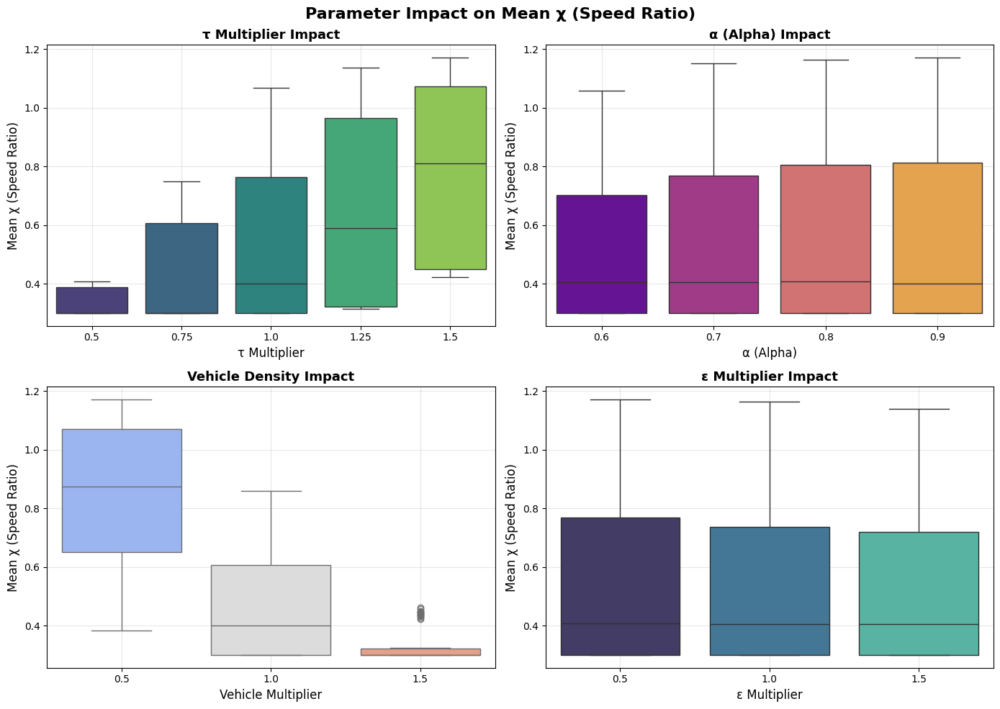

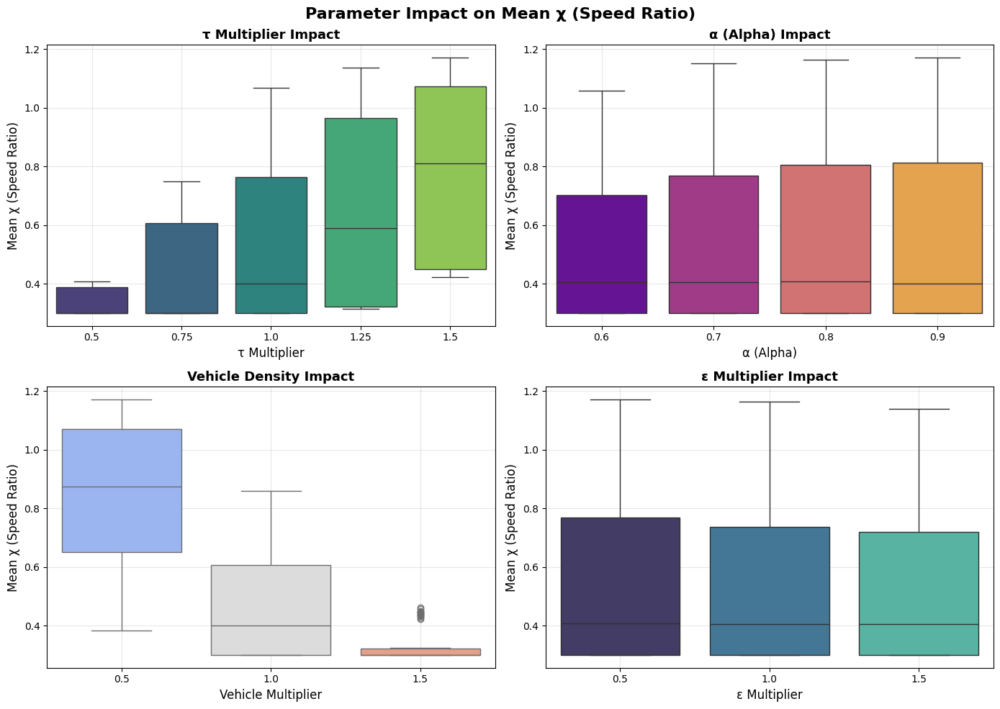

In [15]:
%matplotlib inline
# Parameter Impact Box Plots (2x2 grid)
fig1, axes = plt.subplots(2, 2, figsize=(14, 10))
fig1.suptitle('Parameter Impact on Mean χ (Speed Ratio)', fontsize=16, fontweight='bold', y=0.98)

# Tau multiplier impact
sns.boxplot(data=sensitivity_df, x='tau_mult', y='mean_chi', ax=axes[0,0], palette='viridis')
axes[0,0].set_title('τ Multiplier Impact', fontsize=13, fontweight='bold')
axes[0,0].set_ylabel('Mean χ (Speed Ratio)', fontsize=12)
axes[0,0].set_xlabel('τ Multiplier', fontsize=12)
axes[0,0].grid(True, alpha=0.3)

# Alpha impact
sns.boxplot(data=sensitivity_df, x='alpha', y='mean_chi', ax=axes[0,1], palette='plasma')
axes[0,1].set_title('α (Alpha) Impact', fontsize=13, fontweight='bold')
axes[0,1].set_ylabel('Mean χ (Speed Ratio)', fontsize=12)
axes[0,1].set_xlabel('α (Alpha)', fontsize=12)
axes[0,1].grid(True, alpha=0.3)

# Vehicle multiplier impact
sns.boxplot(data=sensitivity_df, x='veh_mult', y='mean_chi', ax=axes[1,0], palette='coolwarm')
axes[1,0].set_title('Vehicle Density Impact', fontsize=13, fontweight='bold')
axes[1,0].set_ylabel('Mean χ (Speed Ratio)', fontsize=12)
axes[1,0].set_xlabel('Vehicle Multiplier', fontsize=12)
axes[1,0].grid(True, alpha=0.3)

# Epsilon multiplier impact
sns.boxplot(data=sensitivity_df, x='eps_mult', y='mean_chi', ax=axes[1,1], palette='mako')
axes[1,1].set_title('ε Multiplier Impact', fontsize=13, fontweight='bold')
axes[1,1].set_ylabel('Mean χ (Speed Ratio)', fontsize=12)
axes[1,1].set_xlabel('ε Multiplier', fontsize=12)

axes[1,1].grid(True, alpha=0.3)

plt.tight_layout()
plt.show()

from IPython.display import display
display(fig1)

/var/folders/69/8r8f20y50msgx6r9gzr30fkw0000gn/T/ipykernel_71105/2871593087.py:15: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.violinplot(data=sensitivity_df, x='chi_bin', y='tau_mult', ax=axes[0,0], palette='viridis')
/var/folders/69/8r8f20y50msgx6r9gzr30fkw0000gn/T/ipykernel_71105/2871593087.py:23: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.violinplot(data=sensitivity_df, x='chi_bin', y='alpha', ax=axes[0,1], palette='plasma')
/var/folders/69/8r8f20y50msgx6r9gzr30fkw0000gn/T/ipykernel_71105/2871593087.py:31: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.viol

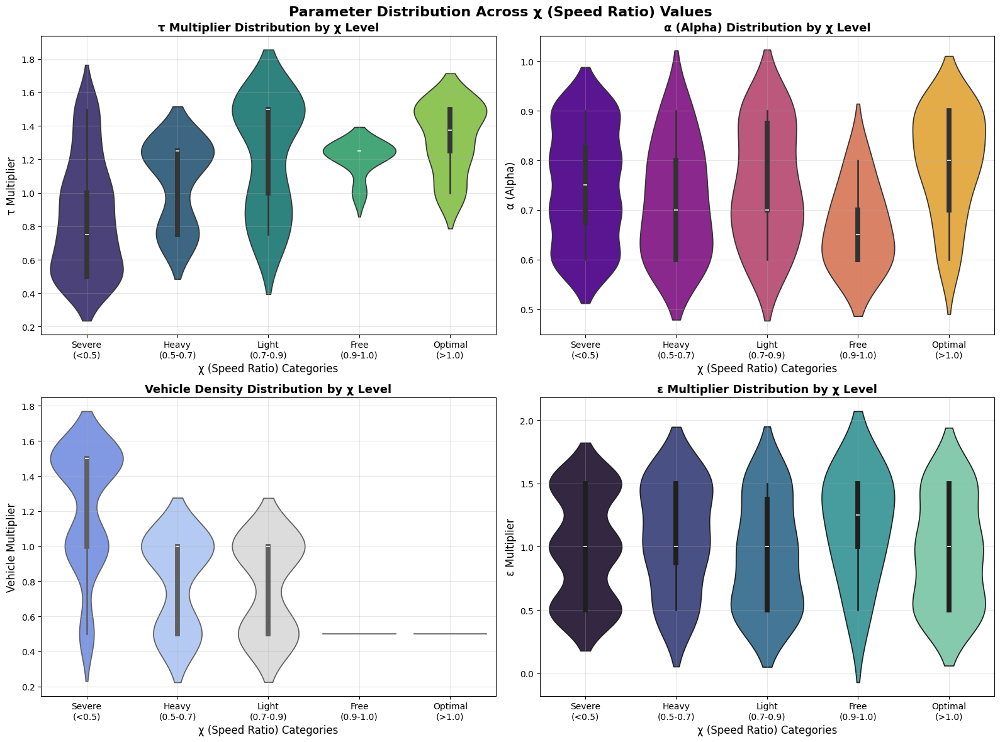

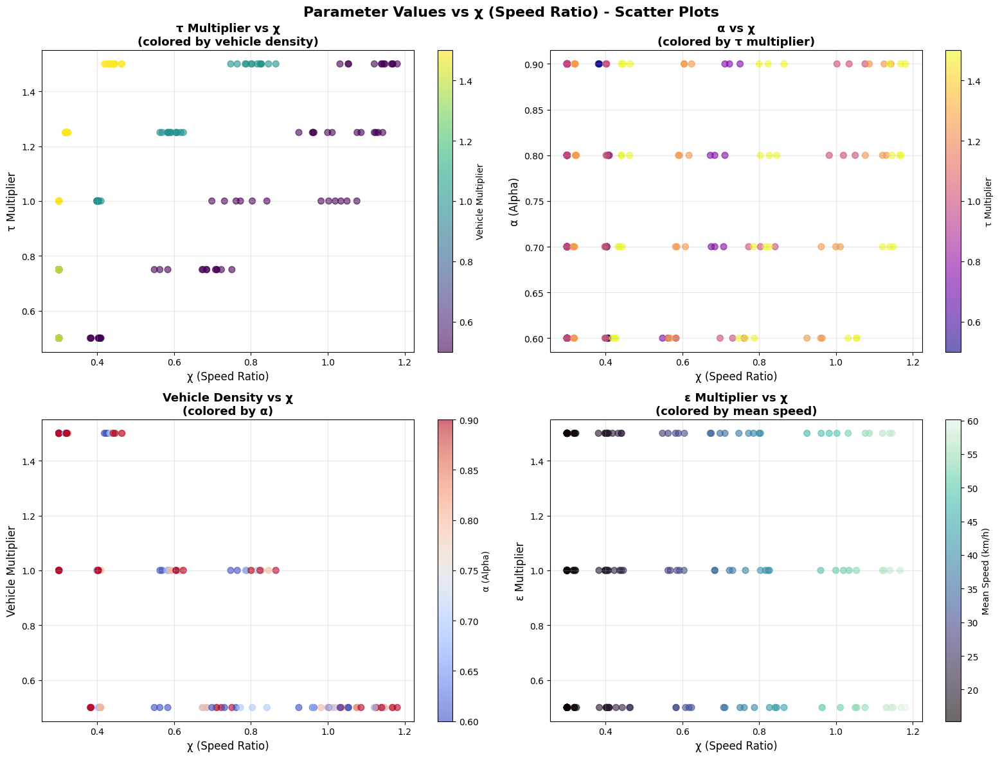


📊 PARAMETER STATISTICS BY CHI CATEGORY:
                 tau_mult               alpha        veh_mult        eps_mult  \
                     mean    std count   mean    std     mean    std     mean   
chi_bin                                                                         
Severe\n(<0.5)      0.861  0.337   108  0.750  0.112    1.222  0.344    1.000   
Heavy\n(0.5-0.7)    1.062  0.242    20  0.720  0.111    0.800  0.251    1.075   
Light\n(0.7-0.9)    1.216  0.330    22  0.750  0.114    0.773  0.255    0.932   
Free\n(0.9-1.0)     1.208  0.102     6  0.667  0.082    0.500  0.000    1.167   
Optimal\n(>1.0)     1.323  0.202    24  0.796  0.104    0.500  0.000    0.958   

                        mean_speed         
                    std       mean    std  
chi_bin                                    
Severe\n(<0.5)    0.410     17.273  2.679  
Heavy\n(0.5-0.7)  0.406     30.787  2.273  
Light\n(0.7-0.9)  0.417     39.485  2.532  
Free\n(0.9-1.0)   0.408     48.983  1.289  
Op

/var/folders/69/8r8f20y50msgx6r9gzr30fkw0000gn/T/ipykernel_71105/2871593087.py:96: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  chi_stats = sensitivity_df.groupby('chi_bin').agg({


In [15]:
%matplotlib inline


# Create violin plots with chi on x-axis and parameters on y-axis
fig, axes = plt.subplots(2, 2, figsize=(16, 12))
fig.suptitle('Parameter Distribution Across χ (Speed Ratio) Values', fontsize=16, fontweight='bold', y=0.98)

# Create chi bins for better visualization
sensitivity_df['chi_bin'] = pd.cut(sensitivity_df['mean_chi'], 
                                  bins=[0, 0.5, 0.7, 0.9, 1.0, 1.5], 
                                  labels=['Severe\n(<0.5)', 'Heavy\n(0.5-0.7)', 'Light\n(0.7-0.9)', 
                                         'Free\n(0.9-1.0)', 'Optimal\n(>1.0)'])

# 1. Tau multiplier vs Chi
sns.violinplot(data=sensitivity_df, x='chi_bin', y='tau_mult', ax=axes[0,0], palette='viridis')
axes[0,0].set_title('τ Multiplier Distribution by χ Level', fontsize=13, fontweight='bold')
axes[0,0].set_xlabel('χ (Speed Ratio) Categories', fontsize=12)
axes[0,0].set_ylabel('τ Multiplier', fontsize=12)
axes[0,0].grid(True, alpha=0.3)
axes[0,0].tick_params(axis='x', rotation=0)

# 2. Alpha vs Chi
sns.violinplot(data=sensitivity_df, x='chi_bin', y='alpha', ax=axes[0,1], palette='plasma')
axes[0,1].set_title('α (Alpha) Distribution by χ Level', fontsize=13, fontweight='bold')
axes[0,1].set_xlabel('χ (Speed Ratio) Categories', fontsize=12)
axes[0,1].set_ylabel('α (Alpha)', fontsize=12)
axes[0,1].grid(True, alpha=0.3)
axes[0,1].tick_params(axis='x', rotation=0)

# 3. Vehicle density vs Chi
sns.violinplot(data=sensitivity_df, x='chi_bin', y='veh_mult', ax=axes[1,0], palette='coolwarm')
axes[1,0].set_title('Vehicle Density Distribution by χ Level', fontsize=13, fontweight='bold')
axes[1,0].set_xlabel('χ (Speed Ratio) Categories', fontsize=12)
axes[1,0].set_ylabel('Vehicle Multiplier', fontsize=12)
axes[1,0].grid(True, alpha=0.3)
axes[1,0].tick_params(axis='x', rotation=0)

# 4. Epsilon vs Chi
sns.violinplot(data=sensitivity_df, x='chi_bin', y='eps_mult', ax=axes[1,1], palette='mako')
axes[1,1].set_title('ε Multiplier Distribution by χ Level', fontsize=13, fontweight='bold')
axes[1,1].set_xlabel('χ (Speed Ratio) Categories', fontsize=12)
axes[1,1].set_ylabel('ε Multiplier', fontsize=12)
axes[1,1].grid(True, alpha=0.3)
axes[1,1].tick_params(axis='x', rotation=0)

plt.tight_layout()
plt.show()

# Alternative: Scatter plots with chi on x-axis
fig2, axes = plt.subplots(2, 2, figsize=(16, 12))
fig2.suptitle('Parameter Values vs χ (Speed Ratio) - Scatter Plots', fontsize=16, fontweight='bold', y=0.98)

# 1. Tau vs Chi scatter
scatter1 = axes[0,0].scatter(sensitivity_df['mean_chi'], sensitivity_df['tau_mult'], 
                            alpha=0.6, c=sensitivity_df['veh_mult'], cmap='viridis', s=50)
axes[0,0].set_xlabel('χ (Speed Ratio)', fontsize=12)
axes[0,0].set_ylabel('τ Multiplier', fontsize=12)
axes[0,0].set_title('τ Multiplier vs χ\n(colored by vehicle density)', fontsize=13, fontweight='bold')
axes[0,0].grid(True, alpha=0.3)
plt.colorbar(scatter1, ax=axes[0,0], label='Vehicle Multiplier')

# 2. Alpha vs Chi scatter
scatter2 = axes[0,1].scatter(sensitivity_df['mean_chi'], sensitivity_df['alpha'], 
                            alpha=0.6, c=sensitivity_df['tau_mult'], cmap='plasma', s=50)
axes[0,1].set_xlabel('χ (Speed Ratio)', fontsize=12)
axes[0,1].set_ylabel('α (Alpha)', fontsize=12)
axes[0,1].set_title('α vs χ\n(colored by τ multiplier)', fontsize=13, fontweight='bold')
axes[0,1].grid(True, alpha=0.3)
plt.colorbar(scatter2, ax=axes[0,1], label='τ Multiplier')

# 3. Vehicle density vs Chi scatter
scatter3 = axes[1,0].scatter(sensitivity_df['mean_chi'], sensitivity_df['veh_mult'], 
                            alpha=0.6, c=sensitivity_df['alpha'], cmap='coolwarm', s=50)
axes[1,0].set_xlabel('χ (Speed Ratio)', fontsize=12)
axes[1,0].set_ylabel('Vehicle Multiplier', fontsize=12)
axes[1,0].set_title('Vehicle Density vs χ\n(colored by α)', fontsize=13, fontweight='bold')
axes[1,0].grid(True, alpha=0.3)
plt.colorbar(scatter3, ax=axes[1,0], label='α (Alpha)')

# 4. Epsilon vs Chi scatter
scatter4 = axes[1,1].scatter(sensitivity_df['mean_chi'], sensitivity_df['eps_mult'], 
                            alpha=0.6, c=sensitivity_df['mean_speed'], cmap='mako', s=50)
axes[1,1].set_xlabel('χ (Speed Ratio)', fontsize=12)
axes[1,1].set_ylabel('ε Multiplier', fontsize=12)
axes[1,1].set_title('ε Multiplier vs χ\n(colored by mean speed)', fontsize=13, fontweight='bold')
axes[1,1].grid(True, alpha=0.3)
plt.colorbar(scatter4, ax=axes[1,1], label='Mean Speed (km/h)')

plt.tight_layout()
plt.show()

# Summary statistics for each chi category
print("\n📊 PARAMETER STATISTICS BY CHI CATEGORY:")
print("="*60)

chi_stats = sensitivity_df.groupby('chi_bin').agg({
    'tau_mult': ['mean', 'std', 'count'],
    'alpha': ['mean', 'std'],
    'veh_mult': ['mean', 'std'], 
    'eps_mult': ['mean', 'std'],
    'mean_speed': ['mean', 'std']
}).round(3)

print(chi_stats)

# Show which parameter combinations lead to best performance
print(f"\n🎯 BEST PERFORMING SCENARIOS (χ > 1.0):")
best_performers = sensitivity_df[sensitivity_df['mean_chi'] > 1.0]
if len(best_performers) > 0:
    print(f"Number of scenarios: {len(best_performers)}")
    print(f"Average τ multiplier: {best_performers['tau_mult'].mean():.2f}")
    print(f"Average α: {best_performers['alpha'].mean():.2f}")
    print(f"Average vehicle multiplier: {best_performers['veh_mult'].mean():.2f}")
    print(f"Average ε multiplier: {best_performers['eps_mult'].mean():.2f}")
else:
    print("No scenarios achieved χ > 1.0")

print(f"\n⚠️ WORST PERFORMING SCENARIOS (χ < 0.5):")
worst_performers = sensitivity_df[sensitivity_df['mean_chi'] < 0.5]
if len(worst_performers) > 0:
    print(f"Number of scenarios: {len(worst_performers)}")
    print(f"Average τ multiplier: {worst_performers['tau_mult'].mean():.2f}")
    print(f"Average α: {worst_performers['alpha'].mean():.2f}")
    print(f"Average vehicle multiplier: {worst_performers['veh_mult'].mean():.2f}")
    print(f"Average ε multiplier: {worst_performers['eps_mult'].mean():.2f}")
else:
    print("No scenarios had χ < 0.5")